In [1]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from datetime import datetime
from datetime import date
import pickle
from pandas_profiling import ProfileReport
import numpy as np
import networkx as nx

# Preprocessing

In [2]:
# loading pre-merged dataset
df=pd.read_csv(r'../data/processed/all_features_and_target_variabes.csv')
df=df.drop(columns=['Unnamed: 0'])
df

,paper_id,indegrees_of_cited_papers_sum,indegrees_of_cited_papers_avg,recency_of_cited_papers_avg,max_time_difference_bw_cited_papers,outdegree,outdegrees_of_cited_papers_sum,outdegrees_of_cited_papers_avg,submitter,submission_date,...,is_revised,times_revised,first_submission_datetime,first_submission_date,num_of_pages,format,journal_counts,first_365_days,label,label_name
0,9509012,317,31.700000,523.000000,947.0,10,99,9.900000,kiyoshi kamimura <kamimurajpnyitp.bitnet@pucc....,"mon, 04 sep 95 13:59:05 jst (16kb) date (rev...",...,1,1,1995-09-04 13:59:05,1995-09-04,15.0,NaN,13.0,2.0,1.0,"(0, 10]"
1,9505051,175,19.444444,146.333333,448.0,9,86,9.555556,ken intriligator <keni@physics.rutgers.edu>,"wed, 10 may 1995 00:36:12 -0400 (10kb)",...,0,0,1995-05-10 00:36:12,1995-05-10,13.0,harvmac,8.0,16.0,2.0,"(10, 20]"
2,9508141,39,6.500000,705.000000,959.0,6,11,1.833333,evansjm@surya11.cern.ch (jonathan evans),"fri, 25 aug 95 19:01:29 +0200 (16kb)",...,0,0,1995-08-25 19:01:29,1995-08-25,16.0,latex,5.0,0.0,0.0,"(-1, 0]"
3,9508159,222,20.181818,273.272727,909.0,11,116,10.545455,"""a.a. kehagias"" <kehagias@sci.kun.nl>","tue, 29 aug 1995 17:14:24 +0200 (8kb)",...,0,0,1995-08-29 17:14:24,1995-08-29,10.0,latex,NaN,1.0,1.0,"(0, 10]"
4,9501050,14,4.666667,357.333333,459.0,3,10,3.333333,igor pesando <pesando@hetws3.nbi.dk>,"fri, 13 jan 1995 15:48:58 +0100 (14kb)",...,0,0,1995-01-13 15:48:58,1995-01-13,1.0,latex,31.0,1.0,1.0,"(0, 10]"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
27765,9309045,0,0.000000,NaN,NaN,0,0,0.000000,hagensenebubecm1.bitnet@frmop11.cnusc.fr,"wed, 08 sep 93 19:43:17 bcn (20kb)",...,0,0,1993-09-08 19:43:17,1993-09-08,19.0,NaN,NaN,3.0,1.0,"(0, 10]"
27766,9310056,14,2.800000,303.000000,168.0,5,8,1.600000,umeki makoto <umeki@tkyux.phys.s.utokyo.ac.jp>,"mon, 11 oct 93 18:22:35 +0900 (50kb) date (r...",...,1,1,1993-10-11 18:22:35,1993-10-11,30.0,NaN,NaN,0.0,0.0,"(-1, 0]"
27767,9312140,19,4.750000,494.250000,368.0,4,0,0.000000,shahn majid <majid@damtp.cambridge.ac.uk>,"wed, 15 dec 93 19:09:59 gmt (53kb) date (rev...",...,1,1,1993-12-15 19:09:59,1993-12-15,29.0,NaN,1.0,0.0,0.0,"(-1, 0]"
27768,9311065,0,0.000000,NaN,NaN,0,0,0.000000,dave robertson <dgr@pacific.mps.ohiostate.edu>,"wed, 10 nov 93 19:04:07 est (19kb)",...,0,0,1993-11-10 19:04:07,1993-11-10,17.0,plain tex,2.0,0.0,0.0,"(-1, 0]"


In [3]:
profile = ProfileReport(df, title="Pandas Profiling Report")
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

### Some more preprocessing to do:
1. Filling NaNs
2. Submitter popularity categorical
3. Journal popularity categorical
4. Format one hot encoding
5. add date from graph
6. drop useless variables: format,
7. Do test-train split based on date 

### Filling NaNs

In [4]:
df.isna().sum()

paper_id                                   0
indegrees_of_cited_papers_sum              0
indegrees_of_cited_papers_avg              0
recency_of_cited_papers_avg             2744
max_time_difference_bw_cited_papers     2744
outdegree                                  0
outdegrees_of_cited_papers_sum             0
outdegrees_of_cited_papers_avg             0
submitter                                  0
submission_date                            0
title                                      0
authors                                    0
comments                                 260
report_no                              12511
journal_ref                             7462
abstract                                   2
submitter_email                            9
submitter_name                          3844
submitter_details                          0
is_revised                                 0
times_revised                              0
first_submission_datetime                671
first_subm

In [5]:
df['recency_of_cited_papers_avg'] = df['recency_of_cited_papers_avg'].fillna(0)
df['max_time_difference_bw_cited_papers'] = df['max_time_difference_bw_cited_papers'].fillna(0)
df['num_of_pages'] = df['num_of_pages'].fillna(0)
df['journal_counts'] = df['journal_counts'].fillna(0)
df['comments'] = df['comments'].fillna("")
df['report_no'] = df['report_no'].fillna("")
df['journal_ref'] = df['journal_ref'].fillna("")
df['abstract'] = df['abstract'].fillna("")
df['submitter_email'] = df['submitter_email'].fillna("")
df['submitter_name'] = df['submitter_name'].fillna("")
df['format'] = df['format'].fillna("")
df=df.dropna(subset = ["first_365_days"])
df.isna().sum()

paper_id                                 0
indegrees_of_cited_papers_sum            0
indegrees_of_cited_papers_avg            0
recency_of_cited_papers_avg              0
max_time_difference_bw_cited_papers      0
outdegree                                0
outdegrees_of_cited_papers_sum           0
outdegrees_of_cited_papers_avg           0
submitter                                0
submission_date                          0
title                                    0
authors                                  0
comments                                 0
report_no                                0
journal_ref                              0
abstract                                 0
submitter_email                          0
submitter_name                           0
submitter_details                        0
is_revised                               0
times_revised                            0
first_submission_datetime              668
first_submission_date                  668
num_of_page

### Creating categorical variable with submitter activity and numerical variable with number of papers submitted by submitter

<AxesSubplot:>

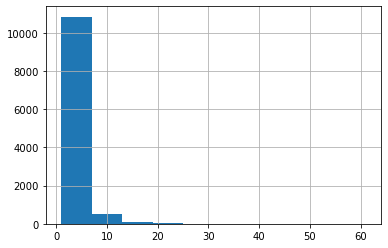

In [6]:
value_counts=df['submitter'].value_counts()
value_counts.hist()

In [7]:
df['submitter_active']=df['submitter'].apply(lambda x: 
                                             1 if value_counts[x]>=5 
                                             else 0)

C:\Users\Sharan Shyamsundar\AppData\Local\Temp\ipykernel_4844\832817413.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['submitter_active']=df['submitter'].apply(lambda x:


In [8]:
df['submitter_active'].value_counts()

0    16696
1    11054
Name: submitter_active, dtype: int64

In [9]:
df['submitter_counts']=df['submitter'].apply(lambda x: value_counts[x])

C:\Users\Sharan Shyamsundar\AppData\Local\Temp\ipykernel_4844\2627388557.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['submitter_counts']=df['submitter'].apply(lambda x: value_counts[x])


### Creating categorical value with journal popularity

In [10]:
df['journal_counts'].describe()

count    27750.000000
mean        36.010955
std         55.643190
min          0.000000
25%          0.000000
50%         13.000000
75%         43.000000
max        245.000000
Name: journal_counts, dtype: float64

In [11]:
df['journal_popularity']=df['journal_counts'].apply(lambda x: 
                                                 1 if x>=13 
                                                 else 0)
df['journal_popularity'].value_counts()

C:\Users\Sharan Shyamsundar\AppData\Local\Temp\ipykernel_4844\152988649.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['journal_popularity']=df['journal_counts'].apply(lambda x:


1    14228
0    13522
Name: journal_popularity, dtype: int64

### One hot encoding the format of submitted paper

In [12]:
df.format.value_counts()

latex                 13594
                       9546
revtex                 1974
harvmac                1497
plain tex               761
latex,latex             157
latex,revtex             96
plaintex                 44
plain tex,harvmac        41
revtex,latex             17
plaintex,harvmac          3
harvmac,harvmac           3
plain tex,latex           3
latex,latex,latex         3
harvmac,latex             3
revtex,revtex             3
latex,revtex,latex        2
levtex                    1
latex,latex,revtex        1
revtex,plaintex           1
Name: format, dtype: int64

In [13]:
df['format_latex']=df['format'].apply(lambda x: 
                                            1 if 'latex' in x 
                                            else 0)
df['format_revtex']=df['format'].apply(lambda x: 
                                            1 if 'revtex' in x 
                                            else 0)
df['format_harvmac']=df['format'].apply(lambda x: 
                                            1 if 'harvmac' in x 
                                            else 0)
df['format_plaintex']=df['format'].apply(lambda x: 
                                            1 if 'plaintex' in x or 'plain tex' in x
                                            else 0)

C:\Users\Sharan Shyamsundar\AppData\Local\Temp\ipykernel_4844\460554433.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['format_latex']=df['format'].apply(lambda x:
C:\Users\Sharan Shyamsundar\AppData\Local\Temp\ipykernel_4844\460554433.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['format_revtex']=df['format'].apply(lambda x:
C:\Users\Sharan Shyamsundar\AppData\Local\Temp\ipykernel_4844\460554433.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFram

### Adding date from graph data

In [14]:
# loading the graph as a netoworkx object
with open(r'..\data\interim\data.pickle','rb') as file:
        data = pickle.load(file)

In [15]:
df['date_added_graph']=df['paper_id'].apply(lambda x: 
                                            data.nodes.data()[x]['time']
                                            )

C:\Users\Sharan Shyamsundar\AppData\Local\Temp\ipykernel_4844\3830430152.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['date_added_graph']=df['paper_id'].apply(lambda x:


### Comparing Date columns from metadata to Date from graph

In [16]:
df[['submission_date','first_submission_datetime','first_submission_date','date_added_graph']]

,submission_date,first_submission_datetime,first_submission_date,date_added_graph
0,"mon, 04 sep 95 13:59:05 jst (16kb) date (rev...",1995-09-04 13:59:05,1995-09-04,1995-08-15
1,"wed, 10 may 1995 00:36:12 -0400 (10kb)",1995-05-10 00:36:12,1995-05-10,1995-05-11
2,"fri, 25 aug 95 19:01:29 +0200 (16kb)",1995-08-25 19:01:29,1995-08-25,1995-08-28
3,"tue, 29 aug 1995 17:14:24 +0200 (8kb)",1995-08-29 17:14:24,1995-08-29,1995-08-30
4,"fri, 13 jan 1995 15:48:58 +0100 (14kb)",1995-01-13 15:48:58,1995-01-13,1995-01-17
...,...,...,...,...
27765,"wed, 08 sep 93 19:43:17 bcn (20kb)",1993-09-08 19:43:17,1993-09-08,1993-09-13
27766,"mon, 11 oct 93 18:22:35 +0900 (50kb) date (r...",1993-10-11 18:22:35,1993-10-11,1993-10-19
27767,"wed, 15 dec 93 19:09:59 gmt (53kb) date (rev...",1993-12-15 19:09:59,1993-12-15,1993-12-21
27768,"wed, 10 nov 93 19:04:07 est (19kb)",1993-11-10 19:04:07,1993-11-10,1993-11-23


Will look at first_submission_date and date_added_graph more closely

In [17]:
df[['first_submission_date','date_added_graph']].describe()

,first_submission_date,date_added_graph
count,27082,27750
unique,3904,2767
top,2002-12-19,1994-10-11
freq,27,42


In [18]:
profile_dates = ProfileReport(df[['first_submission_date','date_added_graph']], title="Pandas Profiling Report")
profile_dates

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Some questions: how does the difference between the two dates look like? What's the average, is it positive/negative?

Maybe fill the missing values in first_submission_date with graph dates. Also these columns can be discarded: 'submission_date','first_submission_datetime','first_submission_date'

Add this difference as a variable. Also extract month of submission from graph date, one-hot-encode it and use as a variable 

In [19]:
def calculate_time_delta(str_first_submission_date,date_added_graph) -> int:
    first_submission_date=np.nan
    datedelta=np.nan
    try:
        first_submission_date=datetime.strptime(str_first_submission_date, '%Y-%m-%d').date()
    except Exception as e:
        pass
    try:
        datedelta=(date_added_graph-first_submission_date).days
    except Exception as e:
        pass
    return datedelta
        
df['datedelta'] = df.apply(lambda x: calculate_time_delta(x.first_submission_date, x.date_added_graph), axis=1)
df['datedelta'] = df['datedelta'].fillna(0)
df['datedelta'].describe()

C:\Users\Sharan Shyamsundar\AppData\Local\Temp\ipykernel_4844\1555205667.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['datedelta'] = df.apply(lambda x: calculate_time_delta(x.first_submission_date, x.date_added_graph), axis=1)
C:\Users\Sharan Shyamsundar\AppData\Local\Temp\ipykernel_4844\1555205667.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['datedelta'] = df['datedelta'].fillna(0)


count    27750.000000
mean        -0.771099
std        102.750671
min      -7795.000000
25%          1.000000
50%          1.000000
75%          3.000000
max       1293.000000
Name: datedelta, dtype: float64

In [20]:
pd.set_option('display.max_rows', 500)
print(df['datedelta'].value_counts())
pd.reset_option('display.max_rows')

 1.0       16076
 3.0        4464
 2.0        2068
 4.0        1211
 0.0        1162
 5.0         671
 6.0         359
 7.0         288
 8.0         129
 11.0        115
 9.0          82
 10.0         77
 13.0         69
 12.0         58
 14.0         50
 15.0         31
 18.0         26
 20.0         26
 17.0         25
 21.0         23
 19.0         22
 16.0         19
 25.0         15
 26.0         15
 32.0         11
 23.0         10
-1.0          10
-2.0           9
 28.0          9
 27.0          9
 31.0          8
 35.0          8
 33.0          8
-12.0          7
-42.0          7
-20.0          7
-29.0          6
 24.0          6
-13.0          6
-34.0          6
 30.0          6
 29.0          6
 22.0          5
 47.0          5
 41.0          5
-48.0          5
-11.0          5
 38.0          5
-140.0         5
-4.0           5
-19.0          5
-15.0          5
-3.0           5
-8.0           5
-7.0           5
-6.0           5
 69.0          4
 54.0          4
-28.0         

In [21]:
profile_date_deltas = ProfileReport(df['datedelta'], title="Pandas Profiling Report")
profile_date_deltas

Analyzing date deltas leads us to the following conclusion: the variable has a few significant outliers, which can influence classification quality. We will keep this in mind.

### Creating submitter activity and journal popularity variables that take time perspective into account

Use graph date to calculate submitter citations till date

In [22]:
PATH_DATES = '../data/raw/hep-th-slacdates_unzipped.txt'
PATH_CITATION ='../data/raw/hep-th-citations_unzipped.txt'
PATH_LABEL = '../data/processed/papers_label.csv'

In [23]:
def read_dates(path):
    df = pd.read_csv(path, sep=' ', header=None, names=['id_paper', 'slac_date'])
    df['slac_date'] = pd.to_datetime(df['slac_date'])
    display(df.head(5))
    return (df)
    

In [24]:
def read_citation(path, df2):
    df1 = pd.read_csv(path, sep=' ', header=None, names=['id_from', 'id_to'])
    # Add dates
    df1 = pd.merge(df1, df2, how="left", left_on='id_from', right_on='id_paper')
    df1 = pd.merge(df1, df2, how="left", left_on='id_to', right_on='id_paper')
    df1.rename(columns={"slac_date_x": "date_from", "slac_date_y": "date_to"}, inplace= True)
    # Select columns
    df1 = df1[['id_from', 'date_from', 'id_to', 'date_to']]
    display(df1.head(5))
    return(df1)
    

In [25]:
df_dates = read_dates(PATH_DATES)

,id_paper,slac_date
0,1001,2000-01-04
1,1002,2000-01-04
2,1003,2000-01-04
3,1004,2000-01-04
4,1005,2000-01-04


In [26]:
df_citation = read_citation(PATH_CITATION, df_dates)
df_citation['date_from'] = pd.to_datetime(df_citation['date_from'], format='%Y-%m-%d')
df_citation['date_to'] = pd.to_datetime(df_citation['date_to'], format='%Y-%m-%d')

,id_from,date_from,id_to,date_to
0,1001,2000-01-04,9304045,1993-04-13
1,1001,2000-01-04,9308122,1993-08-30
2,1001,2000-01-04,9309097,1993-09-24
3,1001,2000-01-04,9311042,1993-11-12
4,1001,2000-01-04,9401139,1994-02-04


In [27]:
def citations_till_date(paper_id, temp_df, df_citation):
    
    submitter = temp_df[temp_df['paper_id'] == paper_id]['submitter_details'].values[0]
    date_limit = temp_df[temp_df['paper_id'] == paper_id]['date_added_graph'].values[0]
    #print(date_limit)
    
    only_sub_papers = temp_df[temp_df['submitter_details'] == submitter]
    submitter_papers_til_date = only_sub_papers[only_sub_papers['date_added_graph'] < date_limit]['paper_id'].tolist()

    citations_of_papers_till_date = df_citation[df_citation['id_to'].isin(submitter_papers_til_date)]
    #print(citations_of_papers_till_date)
    citations_till_date = citations_of_papers_till_date[citations_of_papers_till_date['date_from'] < datetime.strptime(str(date_limit), '%Y-%m-%d')].id_from.count()
    
    values = {'paper_id':paper_id, 'date_added_graph':date_limit, 'citations_till_date': citations_till_date}
    return values

#z = citations_till_date(9404191, temp_df, df_citation)
#z

In [28]:
temp_df = df[['paper_id','submitter_details','date_added_graph']].copy(deep = True)
temp_df = temp_df.sort_values('date_added_graph')

ctd = []
paper_ids = temp_df['paper_id'].tolist()
for i in range(len(temp_df)):
    ctd.append(citations_till_date(paper_ids[i], temp_df, df_citation))

ctd = pd.DataFrame(ctd)
#ctd

In [29]:
df = pd.merge(df, ctd,  how='left', left_on=['paper_id','date_added_graph'], right_on = ['paper_id','date_added_graph'])

In [30]:
df.to_csv(r'../data/processed/all_features_with_further_preprocessing.csv')

### Discarding irrelevant variables

In [59]:
pd.set_option('display.max_columns', 500)
df

,paper_id,indegrees_of_cited_papers_sum,indegrees_of_cited_papers_avg,recency_of_cited_papers_avg,max_time_difference_bw_cited_papers,outdegree,outdegrees_of_cited_papers_sum,outdegrees_of_cited_papers_avg,submitter,submission_date,title,authors,comments,report_no,journal_ref,abstract,submitter_email,submitter_name,is_revised,times_revised,first_submission_datetime,first_submission_date,num_of_pages,format,journal_counts,first_365_days,label,label_name,submitter_active,submitter_counts,journal_popularity,format_latex,format_revtex,format_harvmac,format_plaintex,date_added_graph,datedelta
0,9509012,317,31.700000,523.000000,947.0,10,99,9.900000,kiyoshi kamimura <kamimura%jpnyitp.bitnet@pucc...,"mon, 04 sep 95 13:59:05 jst (16kb) date (rev...",One Loop Anomalies and Wess-Zumino Terms for G...,"J. Gomis, K.Kamimura, J.M. Pons, F. Zamora","15 pages, an example of non-abelian antisymmet...","RIMS-1020, TOHO-FP-9552 and UB-ECM-PF 95/17",Nucl.Phys. B458 (1996),One loop anomalies and their dependence on ant...,kamimura%jpnyitp.bitnet@pucc.princeton.edu,kiyoshi kamimura,1,1,1995-09-04 13:59:05,1995-09-04,15.0,,13.0,2.0,1.0,"(0, 10]",0,4,1,0,0,0,0,1995-08-15,-20.0
1,9505051,175,19.444444,146.333333,448.0,9,86,9.555556,ken intriligator <keni@physics.rutgers.edu>,"wed, 10 may 1995 00:36:12 -0400 (10kb)",New RG Fixed Points and Duality in Supersymmet...,K. Intriligator,"13 pages, harvmac",RU-95-27,Nucl.Phys. B448 (1995),"We present evidence for new, non-trivial RG fi...",keni@physics.rutgers.edu,ken intriligator,0,0,1995-05-10 00:36:12,1995-05-10,13.0,harvmac,8.0,16.0,2.0,"(10, 20]",0,3,0,0,0,1,0,1995-05-11,1.0
2,9508141,39,6.500000,705.000000,959.0,6,11,1.833333,evansjm@surya11.cern.ch (jonathan evans),"fri, 25 aug 95 19:01:29 +0200 (16kb)",Exact Results for Integrable Asymptotically-fr...,"Jonathan M. Evans, Timothy J. Hollowood","16 pages, latex, no figures","CERN-TH/95-230, SWAT/94-95/63",Nucl.Phys.Proc.Suppl. 45A (1996),An account is given of a technique for testing...,evansjm@surya11.cern.ch,jonathan evans,0,0,1995-08-25 19:01:29,1995-08-25,16.0,latex,5.0,0.0,0.0,"(-1, 0]",0,3,0,1,0,0,0,1995-08-28,3.0
3,9508159,222,20.181818,273.272727,909.0,11,116,10.545455,"""a.a. kehagias"" <kehagias@sci.kun.nl>","tue, 29 aug 1995 17:14:24 +0200 (8kb)",A canonical approach to S-duality in Abelian g...,A.A. Kehagias,"latex, 10 pages",NTUA-95/51,,We examine the electric-magnetic duality for a...,kehagias@sci.kun.nl,a.a. kehagias,0,0,1995-08-29 17:14:24,1995-08-29,10.0,latex,0.0,1.0,1.0,"(0, 10]",0,4,0,1,0,0,0,1995-08-30,1.0
4,9501050,14,4.666667,357.333333,459.0,3,10,3.333333,igor pesando <pesando@hetws3.nbi.dk>,"fri, 13 jan 1995 15:48:58 +0100 (14kb)",The Gross-Neveu model on the light cone,Igor Pesando,"latex, 13+1 pages (1 eps z-compressed figure i...",NORDITA-95/3 P,Mod. Phys. Lett. A10 (1995),We consider the (massive) Gross-Neveu model us...,pesando@hetws3.nbi.dk,igor pesando,0,0,1995-01-13 15:48:58,1995-01-13,1.0,latex,31.0,1.0,1.0,"(0, 10]",0,1,1,1,0,0,0,1995-01-17,4.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
27765,9309045,0,0.000000,0.000000,0.0,0,0,0.000000,hagensen%ebubecm1.bitnet@frmop11.cnusc.fr,"wed, 08 sep 93 19:43:17 bcn (20kb)",The Hidden Spatial Geometry of Non-Abelian Gau...,"D.Z. Freedman, P.E. Haagensen, K. Johnson, J.I...","19 pages, tex, ctp #2238",,,The Gauss law constraint in the Hamiltonian fo...,hagensen%ebubecm1.bitnet@frmop11.cnusc.fr,,0,0,1993-09-08 19:43:17,1993-09-08,19.0,,0.0,3.0,1.0,"(0, 10]",0,2,0,0,0,0,0,1993-09-13,5.0
27766,9310056,14,2.800000,303.000000,168.0,5,8,1.600000,umeki makoto <umeki@tkyux.phys.s.u-tokyo.ac.jp>,"mon, 11 oct 93 18:22:35 +0900 (50kb) date (r...",Predictions on Two-dimensional Turbulence by C...,"H. Cateau, Y. Matsuo, M. Umeki","30 pages + 15 figures, ut-652 replaced since t...",,,A generalized theory of two-dimensional isotro...,umeki@tkyux.phys.s.u-tokyo.ac.jp,umeki makoto,1,1,1993

In [60]:
pd.reset_option('display.max_columns')

In [61]:
df=df.drop(columns=['submitter', 'submission_date', 'title', 'authors','comments','report_no',
                    'journal_ref','abstract','submitter_email','submitter_name','first_submission_datetime',
                    'first_submission_date', 'format', 'submitter_active', 'submitter_counts', 'journal_popularity',
                    'journal_counts','datedelta'])

In [63]:
profile_2= ProfileReport(df, title="Pandas Profiling Report")
profile_2

### Doing train-test split

In [67]:
df_train = df[df['date_added_graph']<date(2002, 1, 1)]
df_train=df_train.drop(columns=['date_added_graph'])
df_train=df_train.reset_index(drop=True)
df_train_features=df_train.drop(columns=['first_365_days','label','label_name']) 
df_train_label_class=df_train['label']
df_train_label_numeric=df_train['first_365_days']

df_test = df[df['date_added_graph']>=date(2002, 1, 1)]
df_test=df_test.drop(columns=['date_added_graph'])
df_test=df_test.reset_index(drop=True)
df_test_features=df_test.drop(columns=['first_365_days','label','label_name']) 
df_test_label_class=df_test['label']
df_test_label_numeric=df_test['first_365_days']
df_test_label_numeric

0       20.0
1        0.0
2       22.0
3        2.0
4        2.0
        ... 
4178    20.0
4179     1.0
4180    21.0
4181    37.0
4182    13.0
Name: first_365_days, Length: 4183, dtype: float64

### Trying out linear regression

In [68]:
# create and fit a linear regression
estimator = LinearRegression()
estimator.fit(df_train_features, df_train_label_numeric)
prediction = estimator.predict(df_test_features)

In [70]:
# evaluating
from sklearn.metrics import mean_squared_error, r2_score
from math import sqrt


mse_1 = mean_squared_error(df_test_label_numeric, prediction)
r2_1 = r2_score(df_test_label_numeric, prediction)
print("MSE:", mse_1)
print("RMSE:", sqrt(mse_1))
print("R^2:", r2_1)
print()

MSE: 121.90932085393247
RMSE: 11.041255402078718
R^2: 0.053663440847836585



R squared of 0.05 is very low. 